In [1]:
import glob
import csv
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt
import torch
import random
from patchify import patchify
from PIL import Image as im 

In [2]:
meta = pd.read_csv('./MCSI/metadata.csv')

In [3]:
meta['diagnostic']

0      monkeypox
1      monkeypox
2      monkeypox
3      monkeypox
4      monkeypox
         ...    
395      acne_l3
396      acne_l3
397      acne_l3
398      acne_l3
399      acne_l3
Name: diagnostic, Length: 400, dtype: object

In [4]:
def shuffle_multi_get_zip(X,y):
    
    temp = list(zip(X[0], y[0]))
    print(len(temp))
    temp += list(zip(X[1], y[1]))
    print(len(temp))
    temp += list(zip(X[2], y[2]))
    temp += list(zip(X[3], y[3]))
    random.shuffle(temp)

    return temp
    
    # res1, res2 = zip(*temp)
    # # res1 and res2 come out as tuples, and so must be converted to lists.
    # res1, res2 = np.array(res1), np.array(res2)
    # return res1 ,res2

In [5]:
def shuffle_multi(X,y):
    
    temp = list(zip(X[0], y[0]))
    print(len(temp))
    temp += list(zip(X[1], y[1]))
    print(len(temp))
    temp += list(zip(X[2], y[2]))
    temp += list(zip(X[3], y[3]))
    random.shuffle(temp)
    
    res1, res2 = zip(*temp)
    # res1 and res2 come out as tuples, and so must be converted to lists.
    res1, res2 = np.array(res1), np.array(res2)
    return res1 ,res2

In [6]:
def keep_equal_and_shuffle(X,y , len_of_each_class_in_fold = 10 , k = 10 , imbalanced=0):
    len = len_of_each_class_in_fold
    X_train_final_multi = []
    y_train_final_multi = []
    # X_train_final_bin = []
    # y_train_final_bin = []
    
    
    for i in range(k):
        #multi
        for classes in range(4):
            print(i)
            if imbalanced!=0 and classes==2:
                temp+=list(zip(X[classes][i*len:i*len+len+imbalanced], y[classes][i*len:i*len+len+imbalanced]))
            elif classes==0:
                temp=list(zip(X[classes][i*len:i*len+len], y[classes][i*len:i*len+len]))
            else:
                temp+=list(zip(X[classes][i*len:i*len+len], y[classes][i*len:i*len+len]))
        random.shuffle(temp)
        res1, res2 = zip(*temp)

        X_train_final_multi.append(res1)
        y_train_final_multi.append(res2)
    # res1 and res2 come out as tuples, and so must be converted to lists.
    return X_train_final_multi , y_train_final_multi
            

In [7]:
def shuffle_bin(X,y):
    
    temp = list(zip(X[0], y[0]))
    temp += list(zip(X[1], y[1]))
    
    random.shuffle(temp)
    res1, res2 = zip(*temp)
    # res1 and res2 come out as tuples, and so must be converted to lists.
    res1, res2 = np.array(res1), np.array(res2)
    return res1 ,res2

In [8]:
def get_image_pathes(img, required_size , label):

    if img.shape[0]<224 or img.shape[1]<224:
        
        img = cv2.resize(img, (224,224)).astype(np.float32)
        img = np.moveaxis(img, -1, 0)
        return [img] , [label]
   
    patches = patchify(img , (224,224,3) , step = 224) # step is 224 cuz we dont want overlapped images
    y = []


    x = []
    count = 0
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            for k in range(patches.shape[2]):
                temp = patches[i,j,k, : , : , :].astype(np.float32)
                img_temp = np.moveaxis(temp, -1, 0)
                print(img_temp.shape)
                x.append(img_temp)
                y.append(label)
                count+=1
                if label==[1,0,0,0] and count!=100: #adding more images of chicken pox cuz model not learning well
                    break 
            if label==[1,0,0,0] and count!=100: 
                break
        if label==[1,0,0,0] and count!=100: 
            break
    return x, y

(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 22

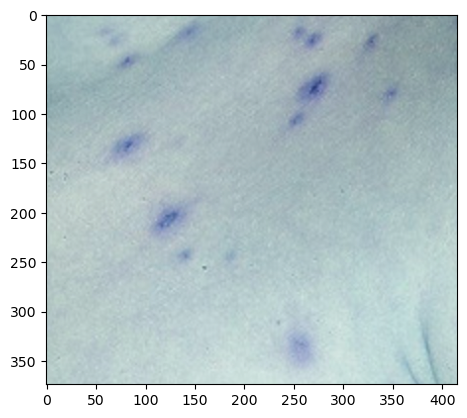

./MCSI/images/chickenpox_6.png
1
(3, 224, 224)


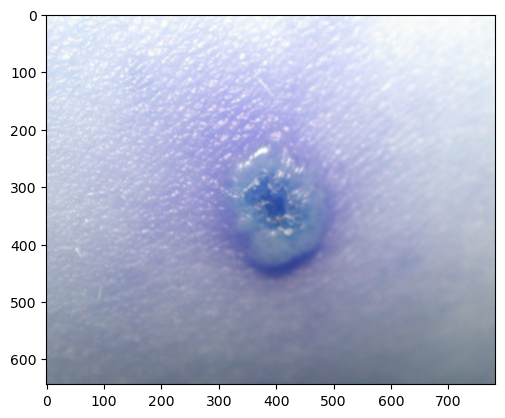

./MCSI/images/chickenpox_10.png
2
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


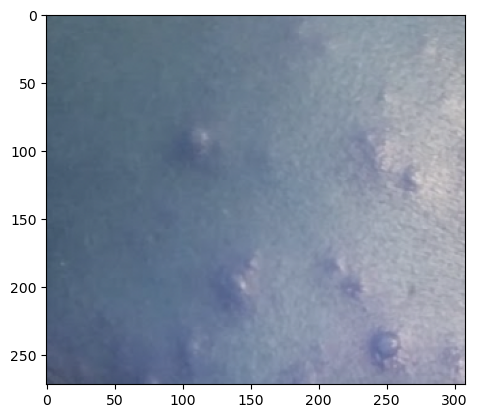

./MCSI/images/chickenpox_38.png
3
(3, 224, 224)


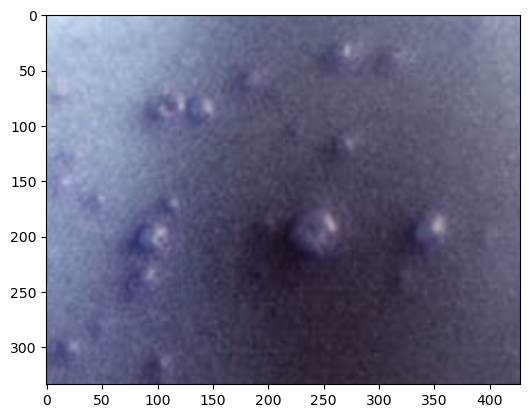

./MCSI/images/chickenpox_39.png
4
(3, 224, 224)


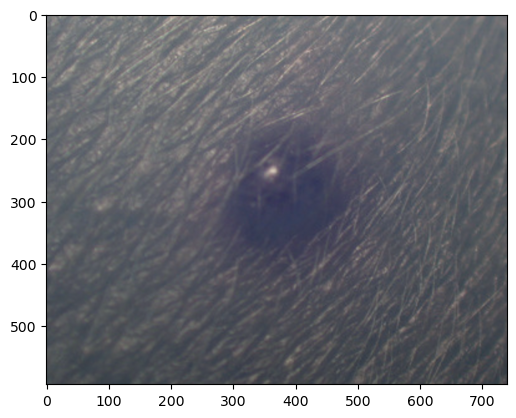

./MCSI/images/chickenpox_11.png
5
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


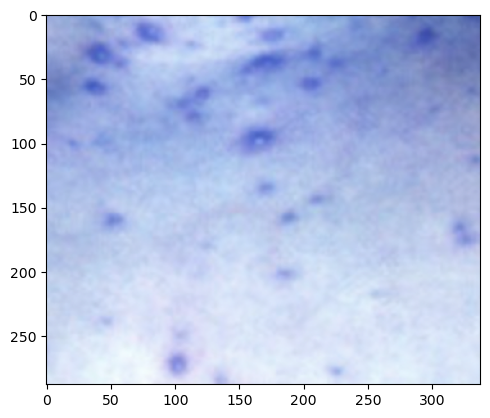

./MCSI/images/chickenpox_7.png
6
(3, 224, 224)


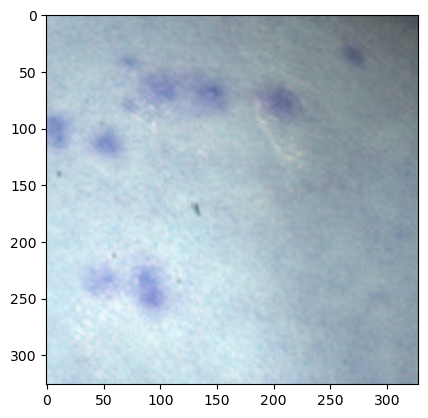

./MCSI/images/chickenpox_5.png
7
(3, 224, 224)


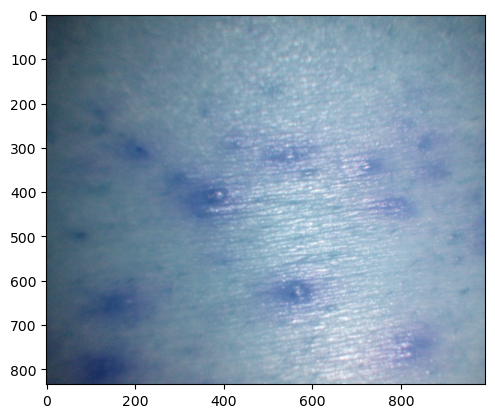

./MCSI/images/chickenpox_13.png
8
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


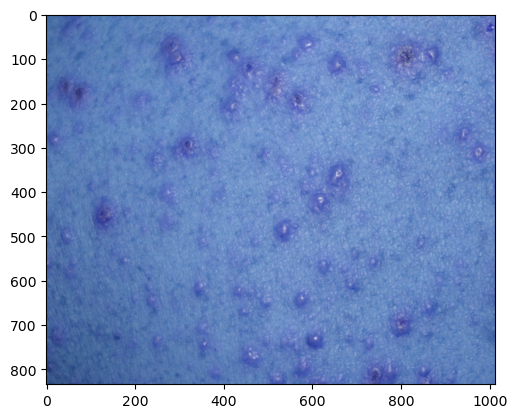

./MCSI/images/chickenpox_12.png
9
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


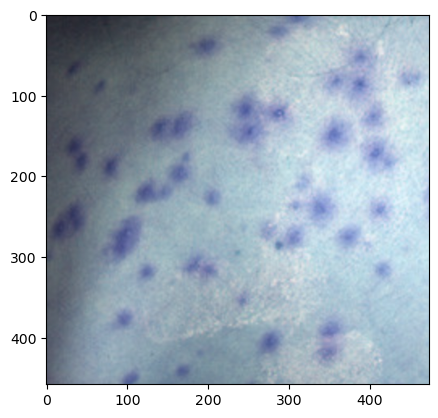

./MCSI/images/chickenpox_4.png
10
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


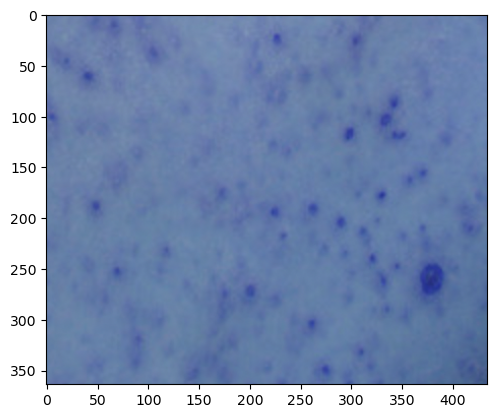

./MCSI/images/chickenpox_16.png
11
(3, 224, 224)


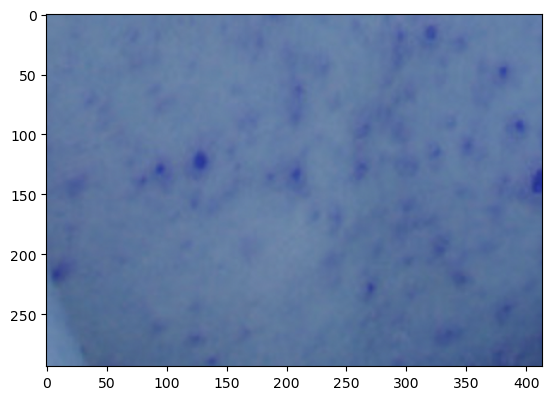

./MCSI/images/chickenpox_17.png
12
(3, 224, 224)


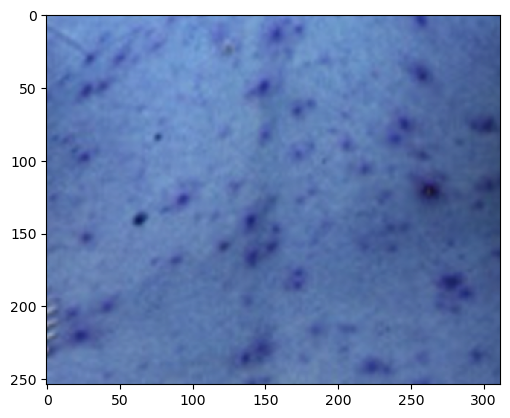

./MCSI/images/chickenpox_1.png
13
(3, 224, 224)


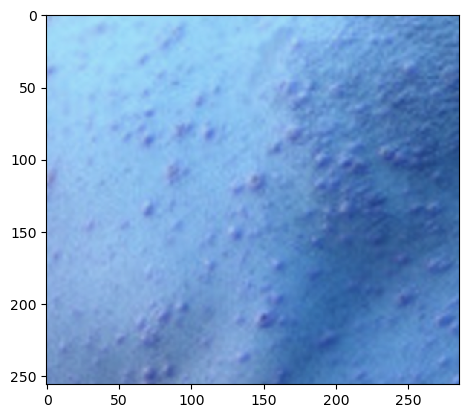

./MCSI/images/chickenpox_3.png
14
(3, 224, 224)


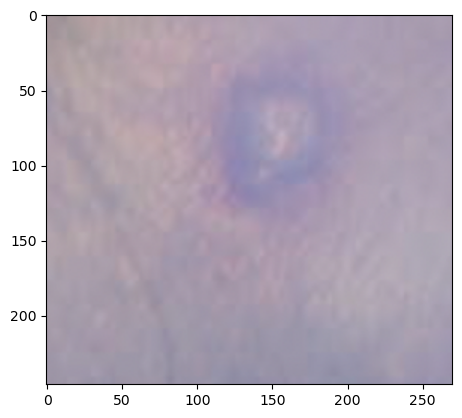

./MCSI/images/chickenpox_29.png
15
(3, 224, 224)


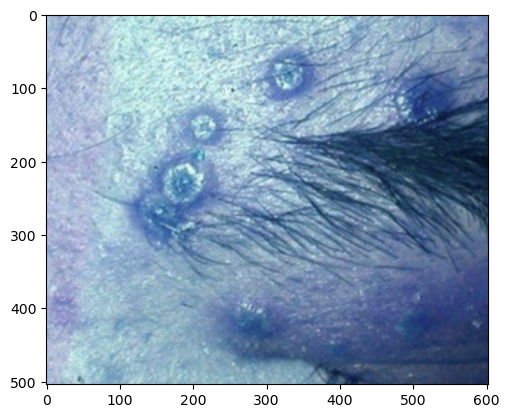

./MCSI/images/chickenpox_15.png
16
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


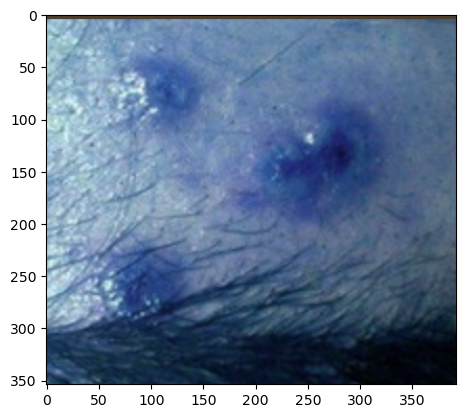

./MCSI/images/chickenpox_14.png
17
(3, 224, 224)


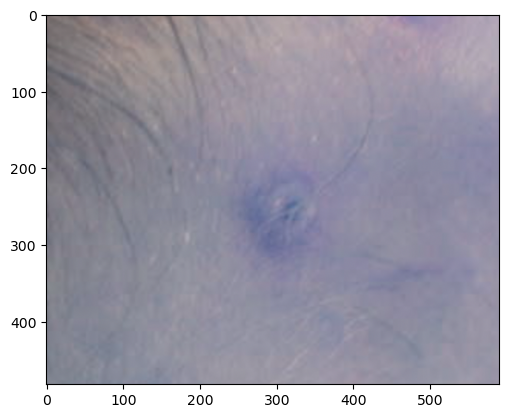

./MCSI/images/chickenpox_28.png
18
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


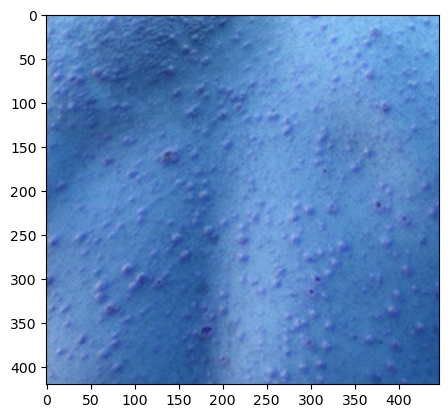

./MCSI/images/chickenpox_2.png
19
(3, 224, 224)


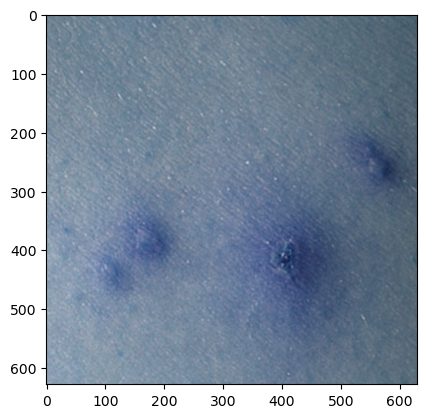

./MCSI/images/chickenpox_98.png
20
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


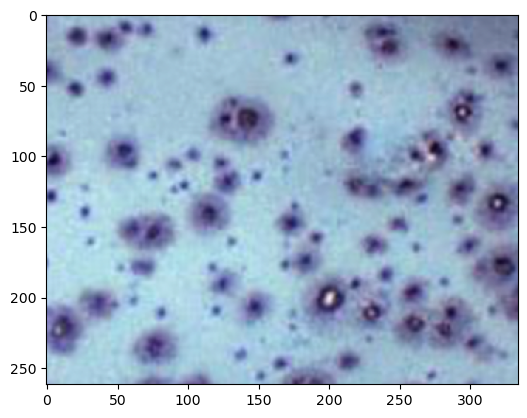

./MCSI/images/chickenpox_73.png
21
(3, 224, 224)


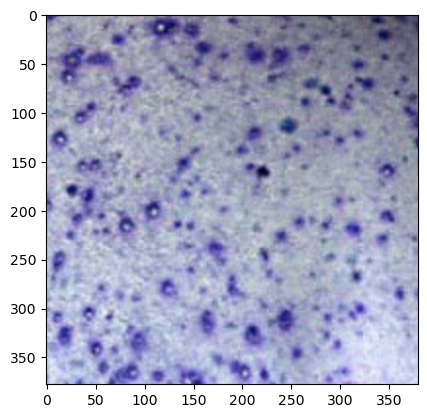

./MCSI/images/chickenpox_67.png
22
(3, 224, 224)


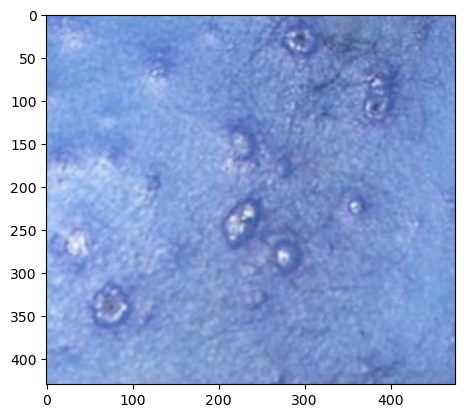

./MCSI/images/chickenpox_66.png
23
(3, 224, 224)
(3, 224, 224)


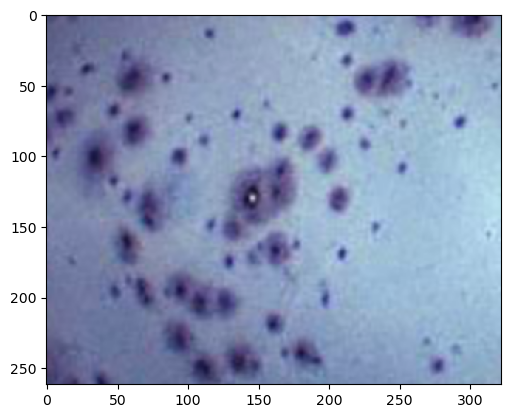

./MCSI/images/chickenpox_72.png
24
(3, 224, 224)


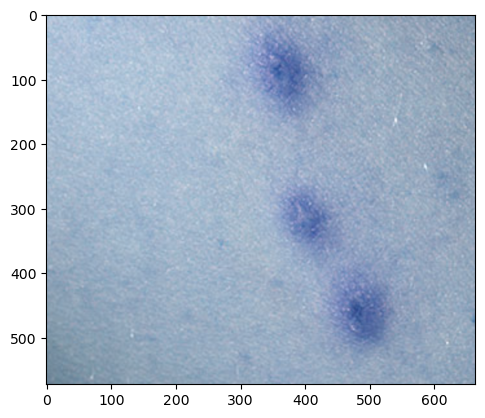

./MCSI/images/chickenpox_99.png
25
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


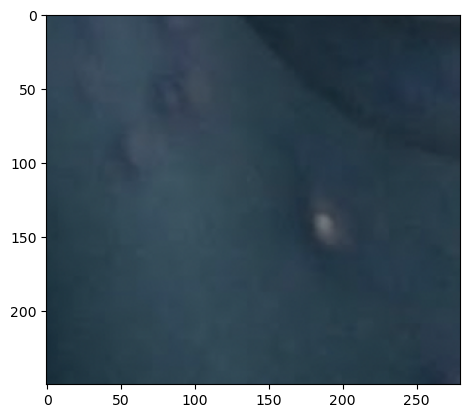

./MCSI/images/chickenpox_64.png
26
(3, 224, 224)


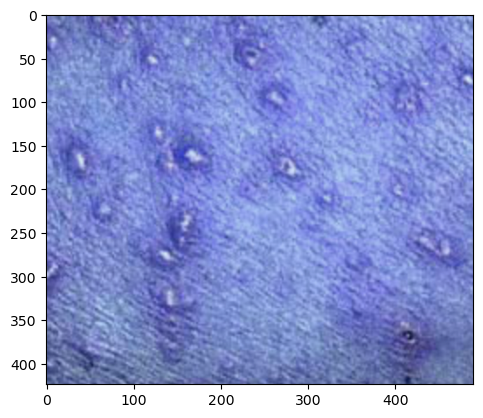

./MCSI/images/chickenpox_70.png
27
(3, 224, 224)
(3, 224, 224)


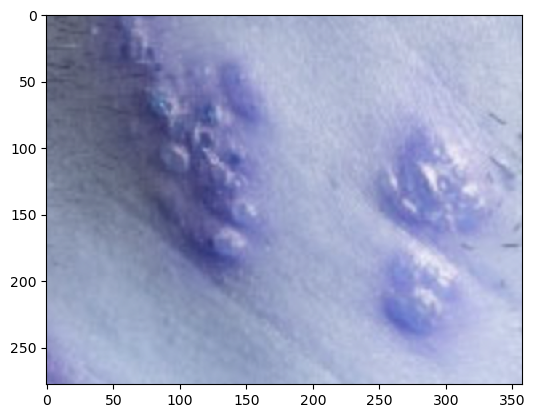

./MCSI/images/chickenpox_58.png
28
(3, 224, 224)


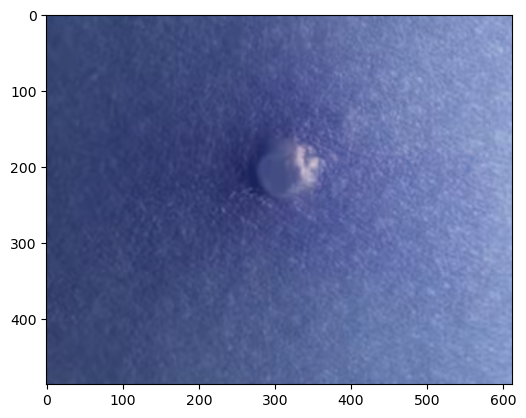

./MCSI/images/chickenpox_59.png
29
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


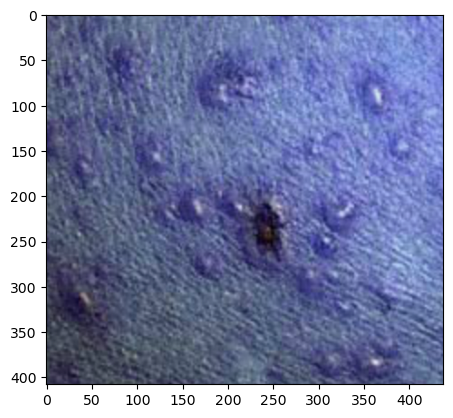

./MCSI/images/chickenpox_71.png
30
(3, 224, 224)


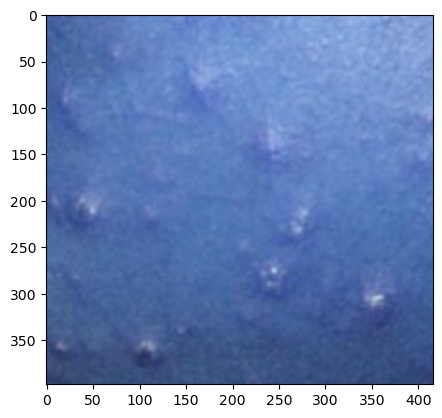

./MCSI/images/chickenpox_65.png
31
(3, 224, 224)


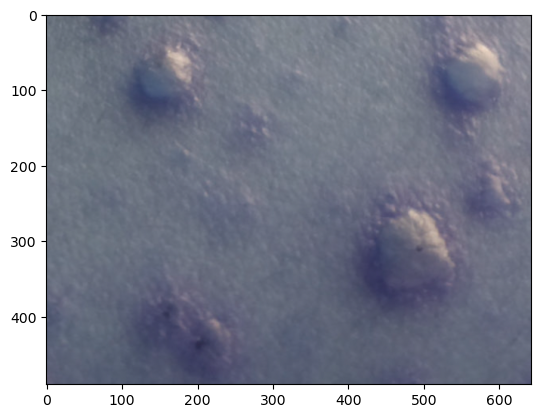

./MCSI/images/chickenpox_49.png
32
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


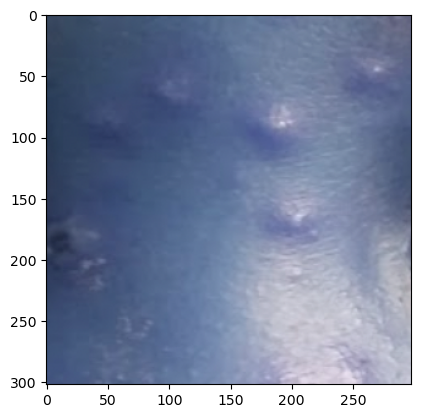

./MCSI/images/chickenpox_61.png
33
(3, 224, 224)


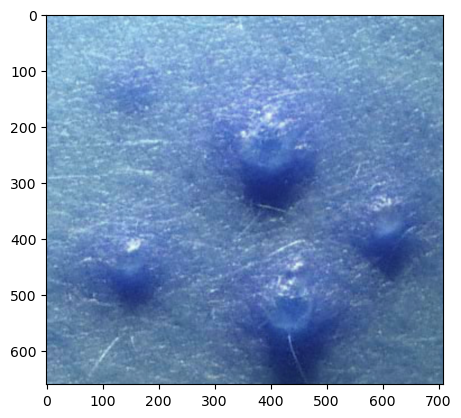

./MCSI/images/chickenpox_75.png
34
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


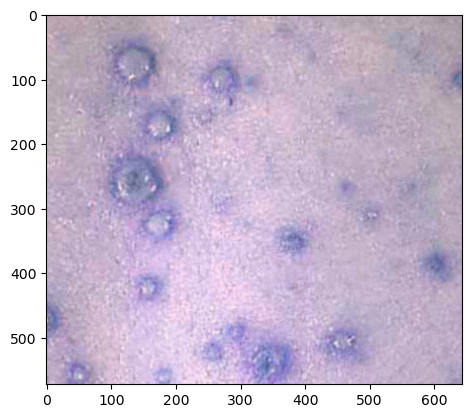

./MCSI/images/chickenpox_74.png
35
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


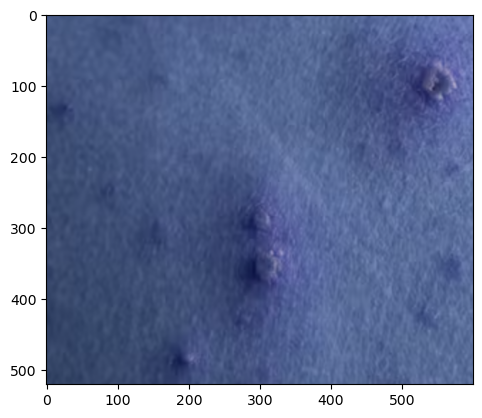

./MCSI/images/chickenpox_60.png
36
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


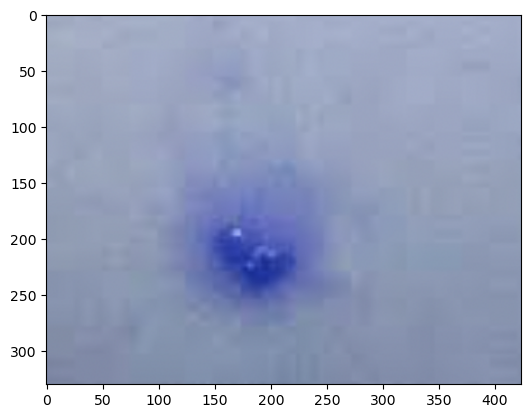

./MCSI/images/chickenpox_48.png
37
(3, 224, 224)


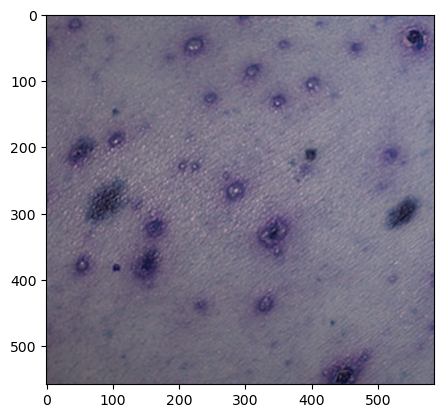

./MCSI/images/chickenpox_100.png
38
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


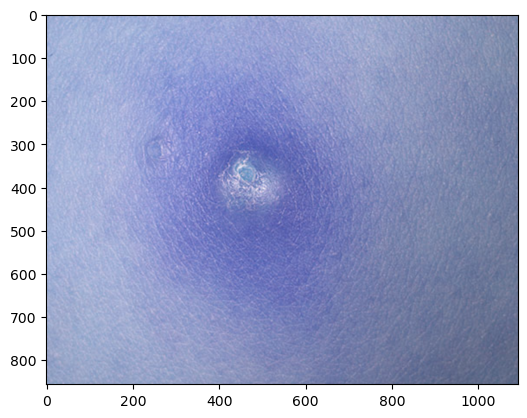

./MCSI/images/chickenpox_89.png
39
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


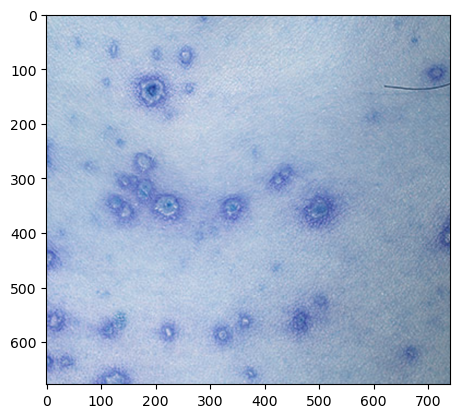

./MCSI/images/chickenpox_76.png
40
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


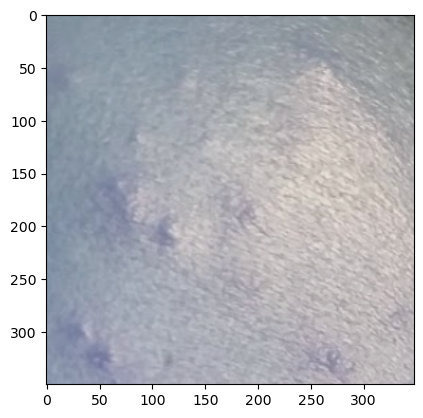

./MCSI/images/chickenpox_62.png
41
(3, 224, 224)


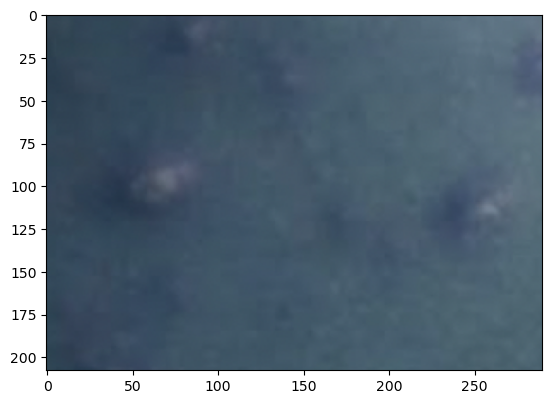

./MCSI/images/chickenpox_63.png
42


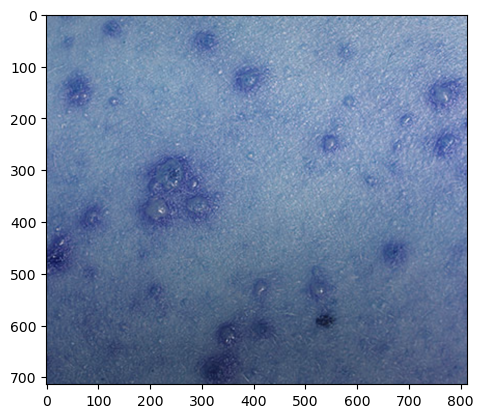

./MCSI/images/chickenpox_77.png
43
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


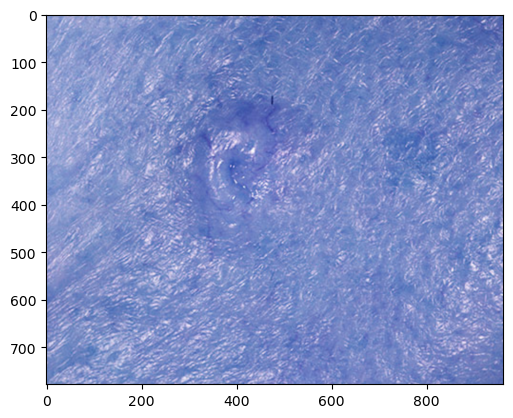

./MCSI/images/chickenpox_88.png
44
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


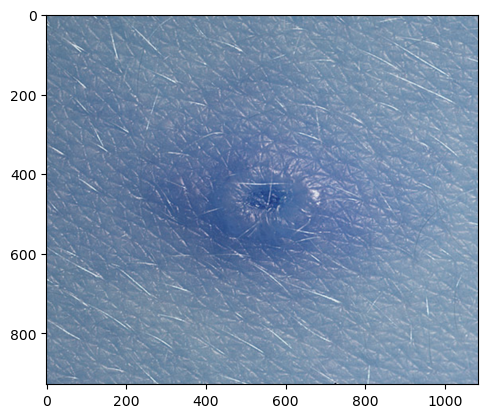

./MCSI/images/chickenpox_91.png
45
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


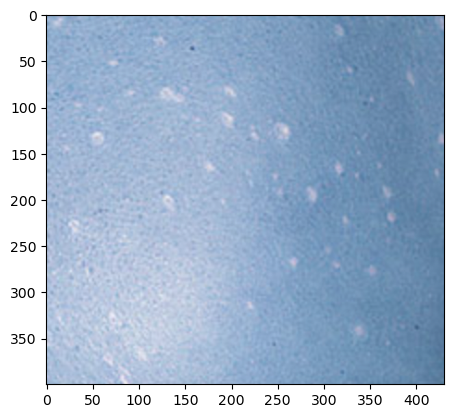

./MCSI/images/chickenpox_85.png
46
(3, 224, 224)


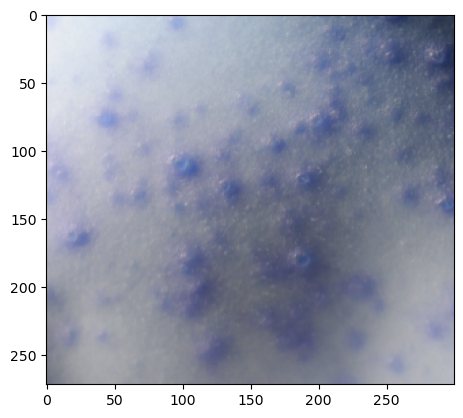

./MCSI/images/chickenpox_52.png
47
(3, 224, 224)


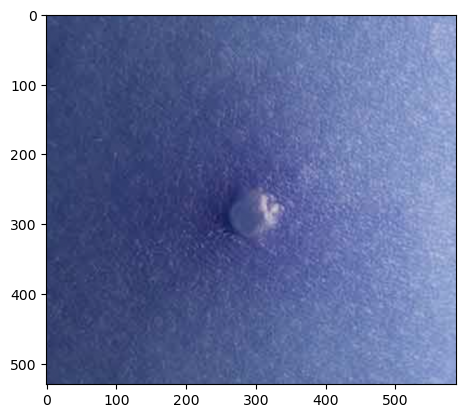

./MCSI/images/chickenpox_46.png
48
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


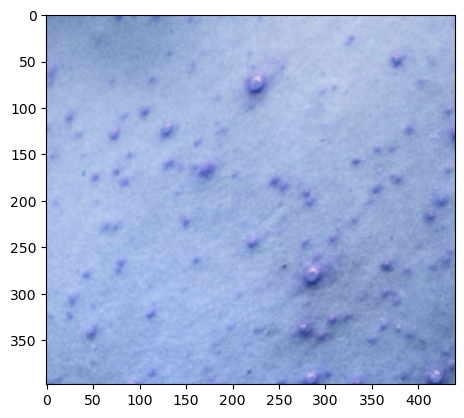

./MCSI/images/chickenpox_47.png
49
(3, 224, 224)


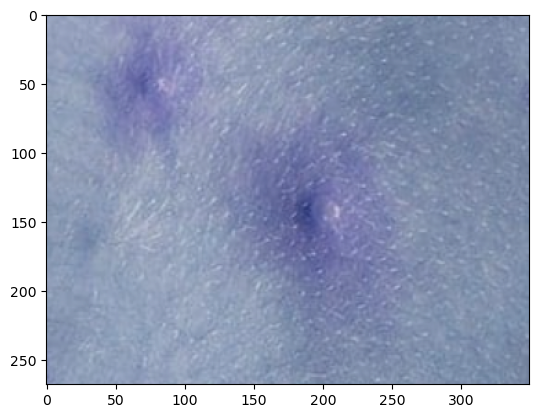

./MCSI/images/chickenpox_53.png
50
(3, 224, 224)


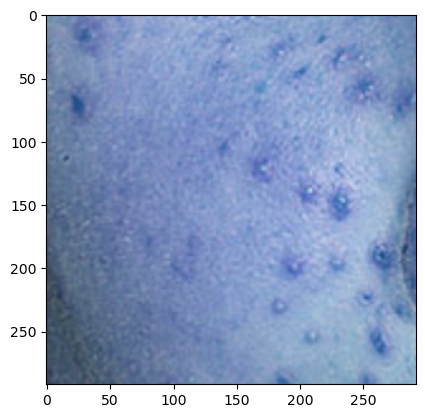

./MCSI/images/chickenpox_84.png
51
(3, 224, 224)


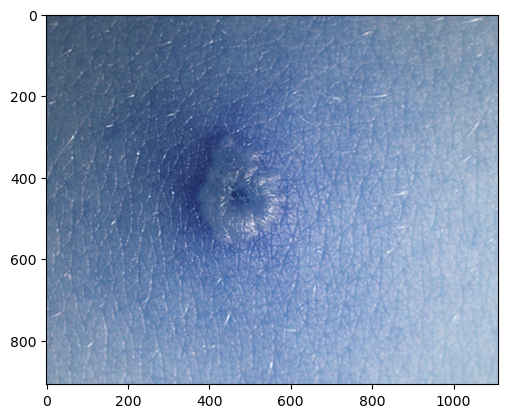

./MCSI/images/chickenpox_90.png
52
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


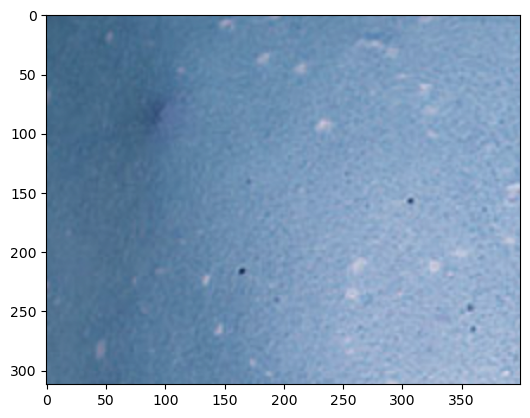

./MCSI/images/chickenpox_86.png
53
(3, 224, 224)


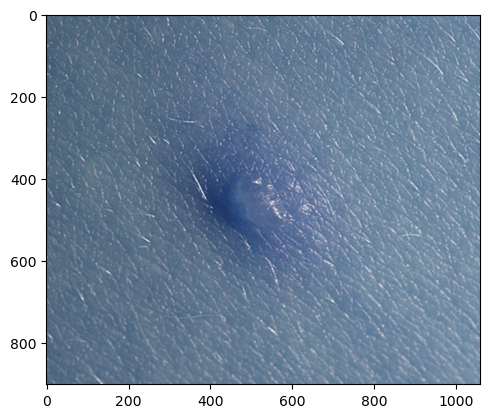

./MCSI/images/chickenpox_92.png
54
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


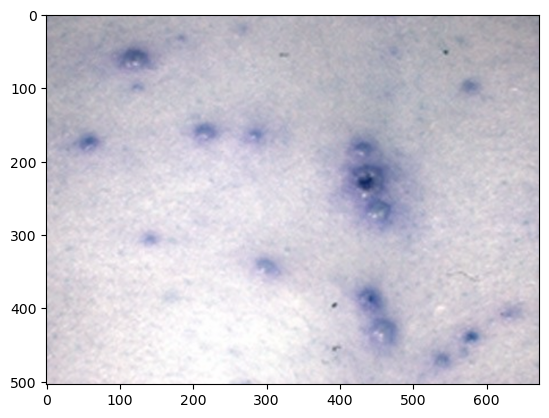

./MCSI/images/chickenpox_45.png
55
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


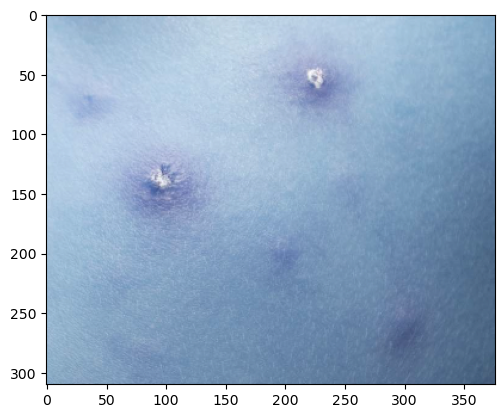

./MCSI/images/chickenpox_51.png
56
(3, 224, 224)


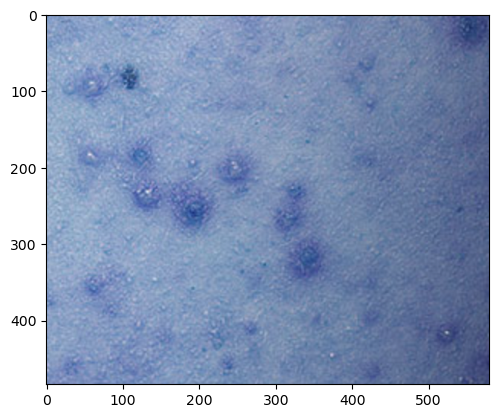

./MCSI/images/chickenpox_79.png
57
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


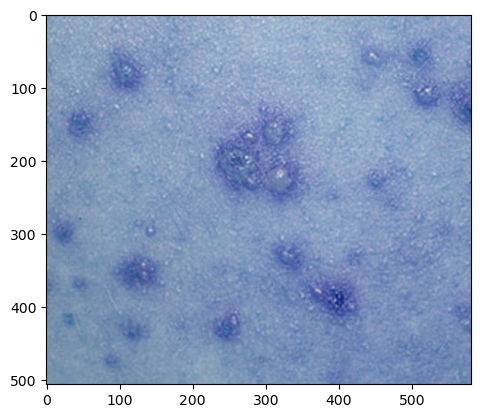

./MCSI/images/chickenpox_78.png
58
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


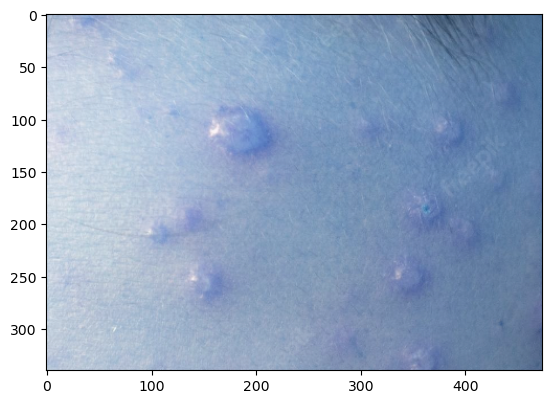

./MCSI/images/chickenpox_50.png
59
(3, 224, 224)
(3, 224, 224)


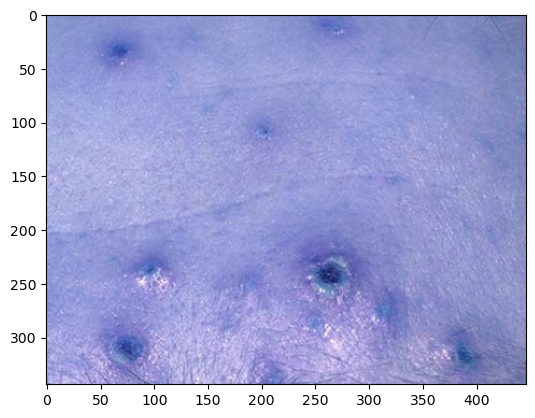

./MCSI/images/chickenpox_44.png
60
(3, 224, 224)


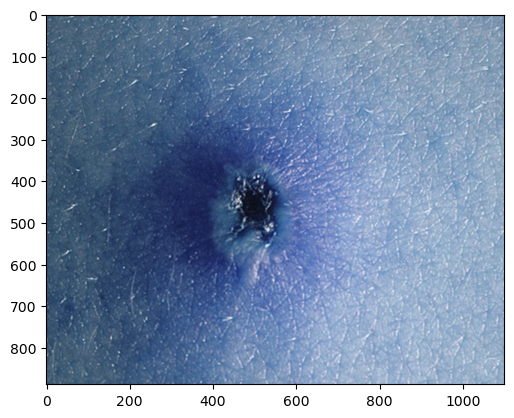

./MCSI/images/chickenpox_93.png
61
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


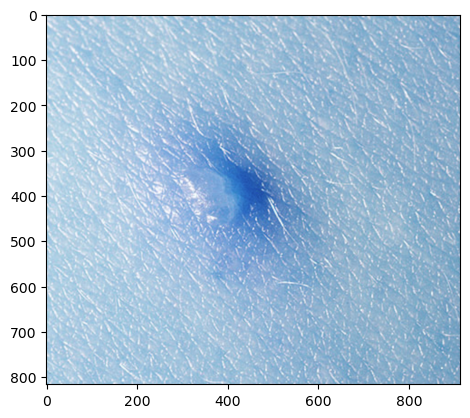

./MCSI/images/chickenpox_87.png
62
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


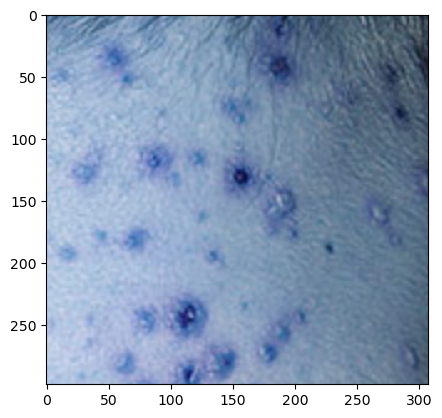

./MCSI/images/chickenpox_83.png
63
(3, 224, 224)


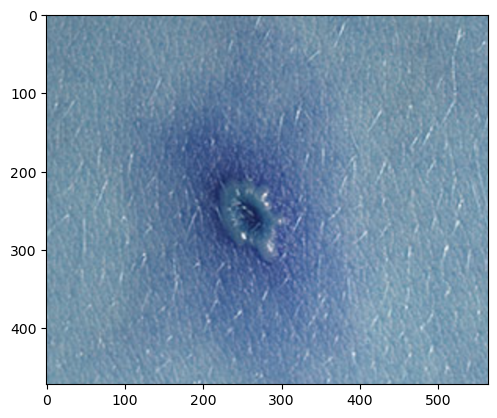

./MCSI/images/chickenpox_97.png
64
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


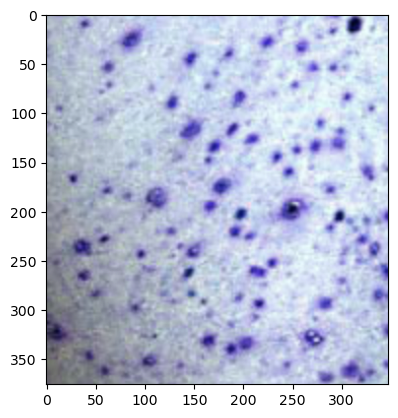

./MCSI/images/chickenpox_68.png
65
(3, 224, 224)


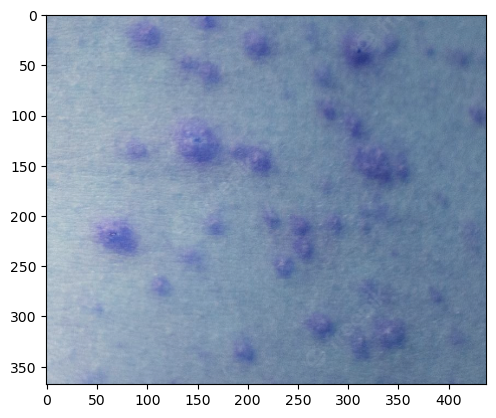

./MCSI/images/chickenpox_40.png
66
(3, 224, 224)


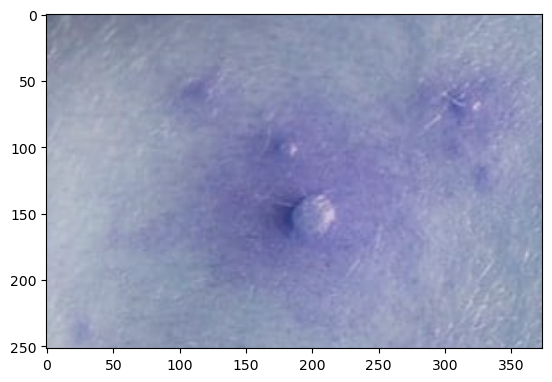

./MCSI/images/chickenpox_54.png
67
(3, 224, 224)


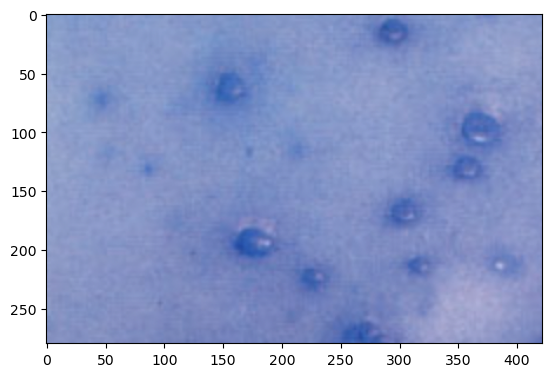

./MCSI/images/chickenpox_55.png
68
(3, 224, 224)


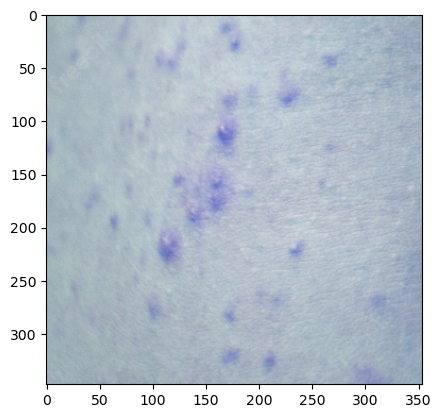

./MCSI/images/chickenpox_41.png
69
(3, 224, 224)


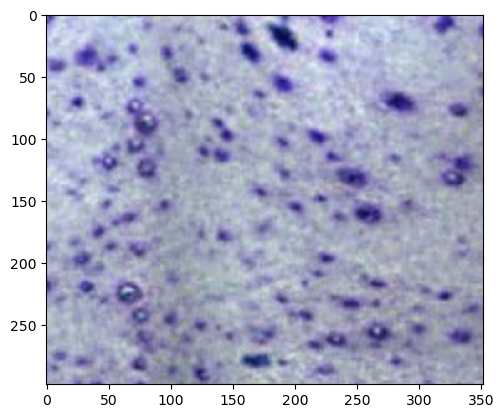

./MCSI/images/chickenpox_69.png
70
(3, 224, 224)


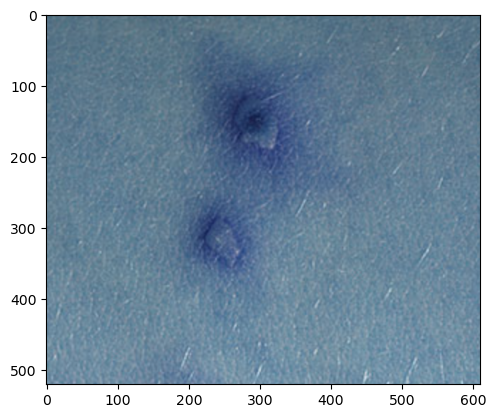

./MCSI/images/chickenpox_96.png
71
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


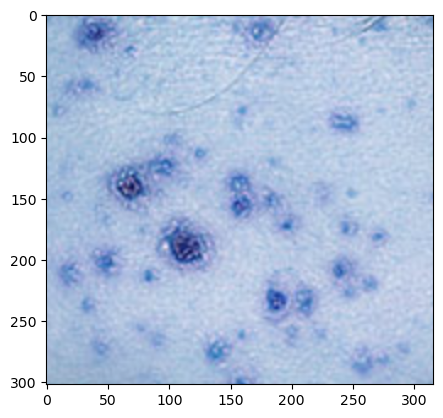

./MCSI/images/chickenpox_82.png
72
(3, 224, 224)


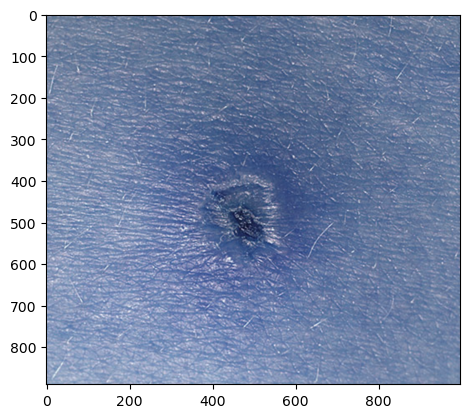

./MCSI/images/chickenpox_94.png
73
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


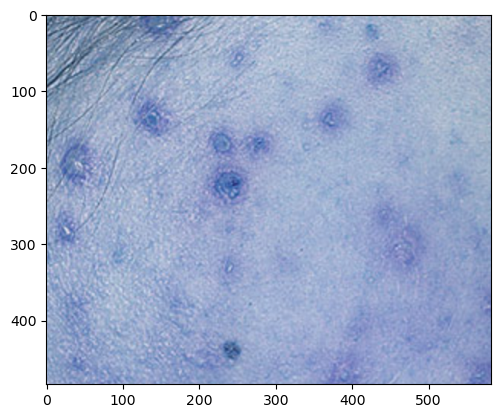

./MCSI/images/chickenpox_80.png
74
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


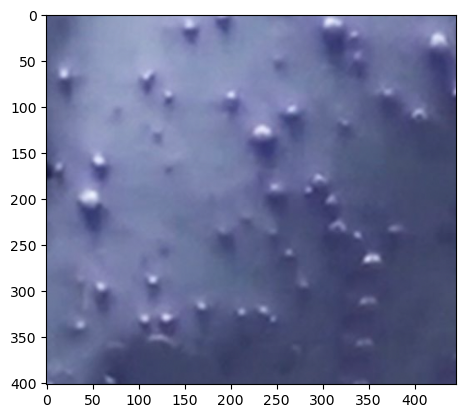

./MCSI/images/chickenpox_57.png
75
(3, 224, 224)


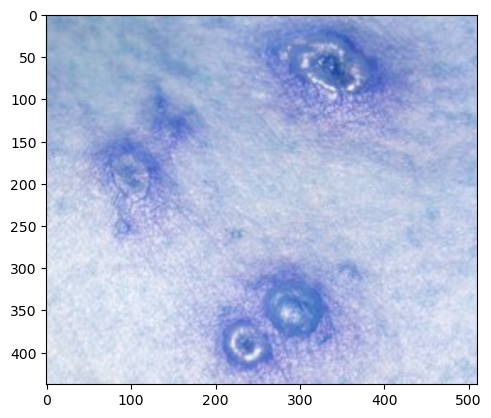

./MCSI/images/chickenpox_43.png
76
(3, 224, 224)
(3, 224, 224)


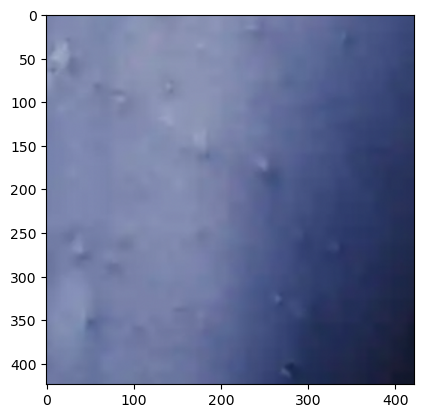

./MCSI/images/chickenpox_42.png
77
(3, 224, 224)


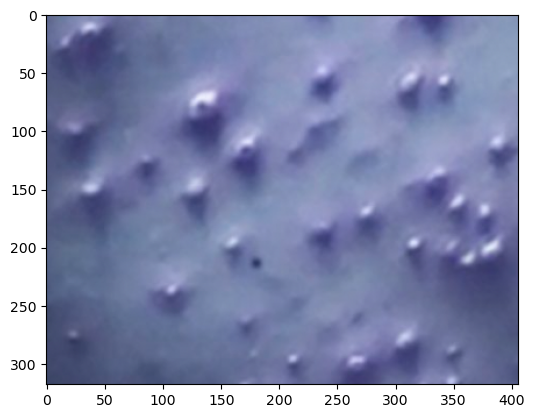

./MCSI/images/chickenpox_56.png
78
(3, 224, 224)


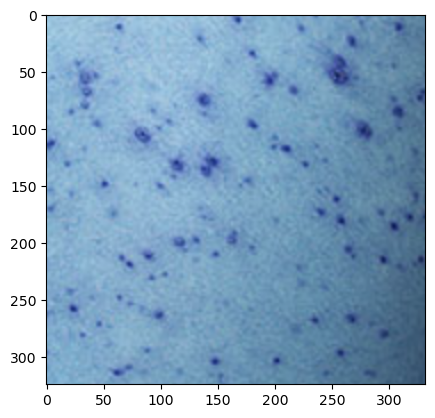

./MCSI/images/chickenpox_81.png
79
(3, 224, 224)


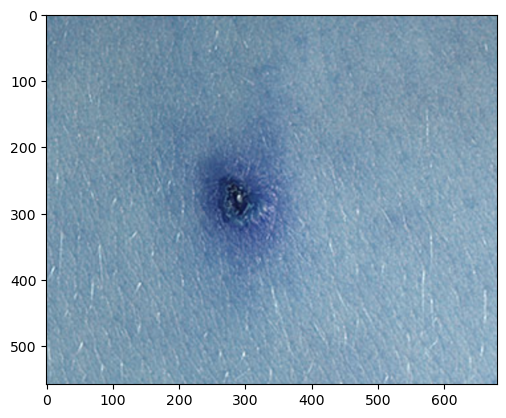

./MCSI/images/chickenpox_95.png
80
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


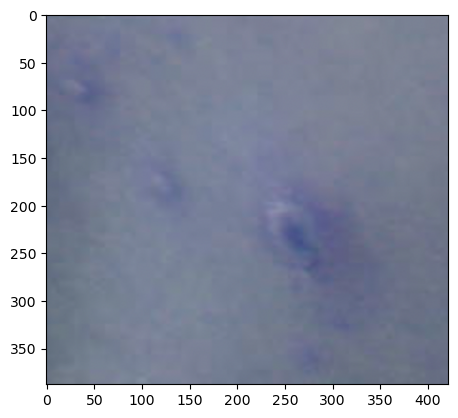

./MCSI/images/chickenpox_31.png
81
(3, 224, 224)


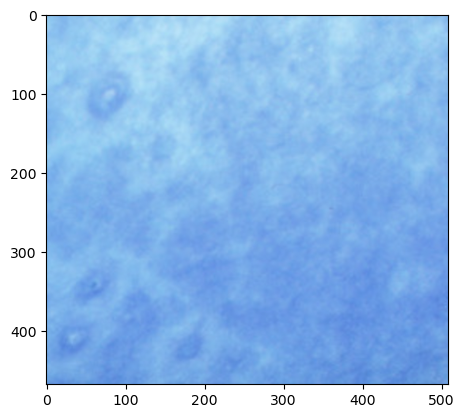

./MCSI/images/chickenpox_25.png
82
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


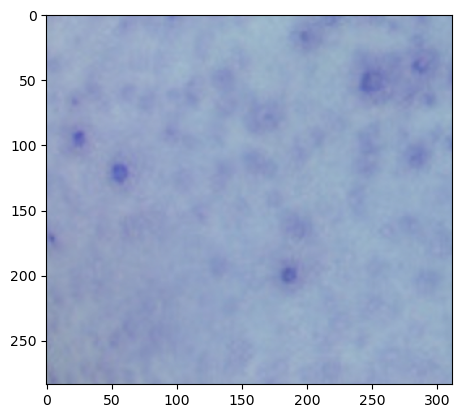

./MCSI/images/chickenpox_19.png
83
(3, 224, 224)


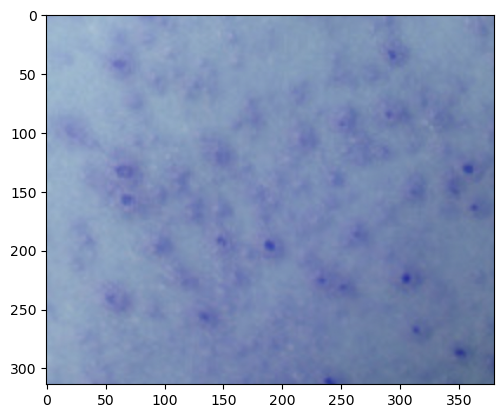

./MCSI/images/chickenpox_18.png
84
(3, 224, 224)


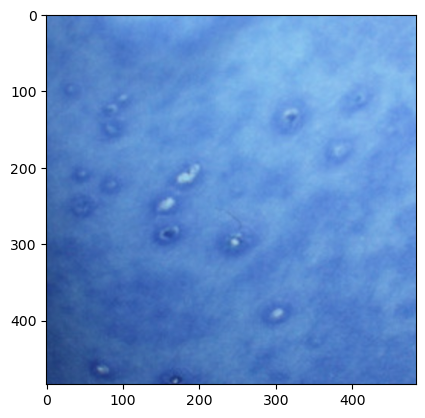

./MCSI/images/chickenpox_24.png
85
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


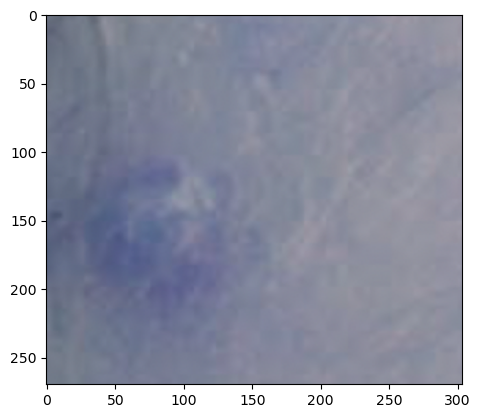

./MCSI/images/chickenpox_30.png
86
(3, 224, 224)


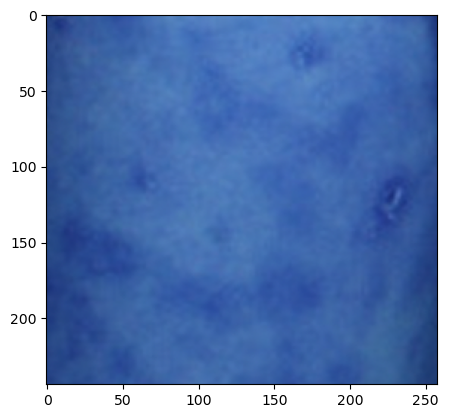

./MCSI/images/chickenpox_26.png
87
(3, 224, 224)


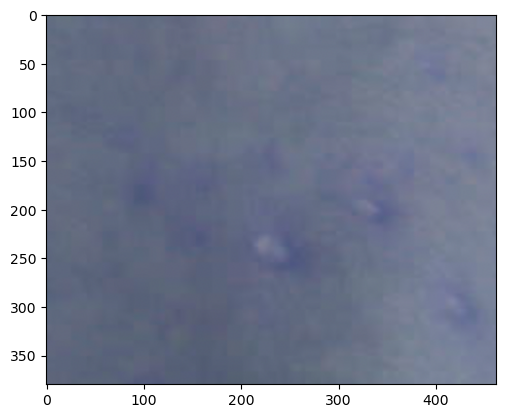

./MCSI/images/chickenpox_32.png
88
(3, 224, 224)
(3, 224, 224)


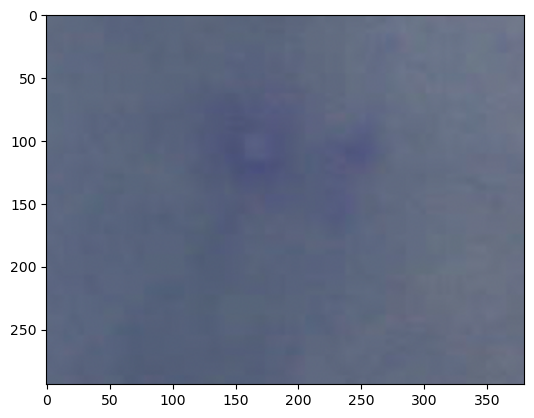

./MCSI/images/chickenpox_33.png
89
(3, 224, 224)


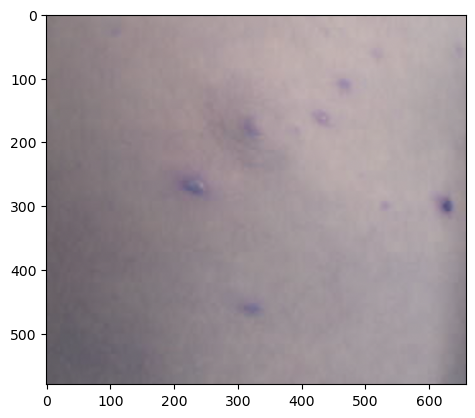

./MCSI/images/chickenpox_27.png
90
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


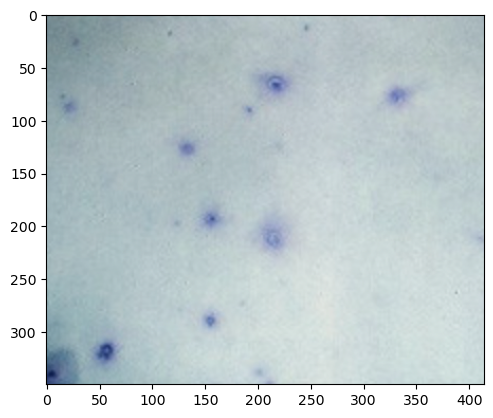

./MCSI/images/chickenpox_9.png
91
(3, 224, 224)


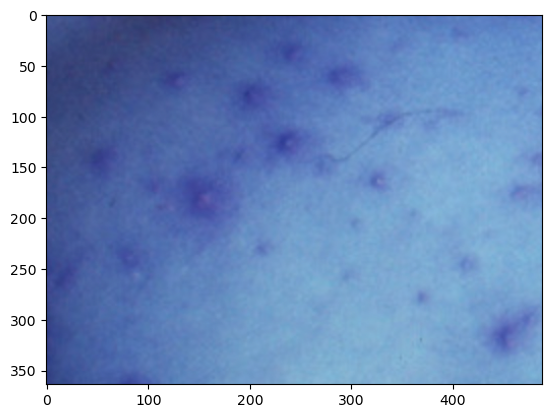

./MCSI/images/chickenpox_23.png
92
(3, 224, 224)
(3, 224, 224)


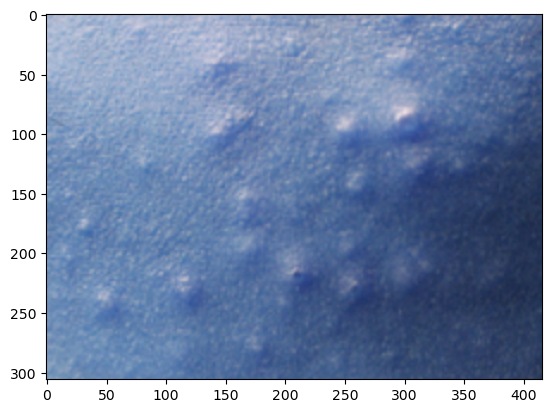

./MCSI/images/chickenpox_37.png
93
(3, 224, 224)


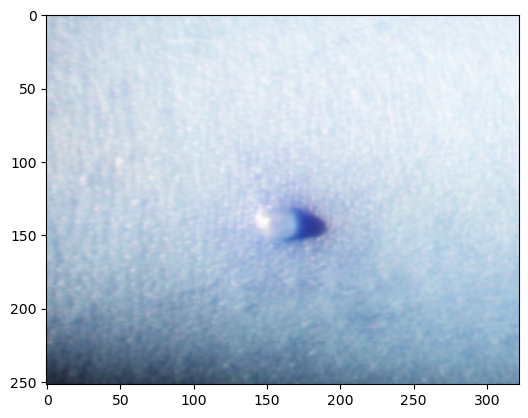

./MCSI/images/chickenpox_36.png
94
(3, 224, 224)


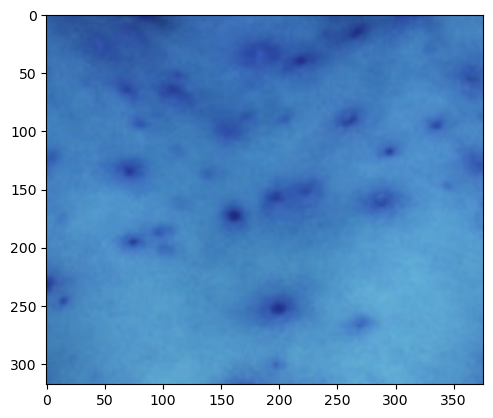

./MCSI/images/chickenpox_22.png
95
(3, 224, 224)


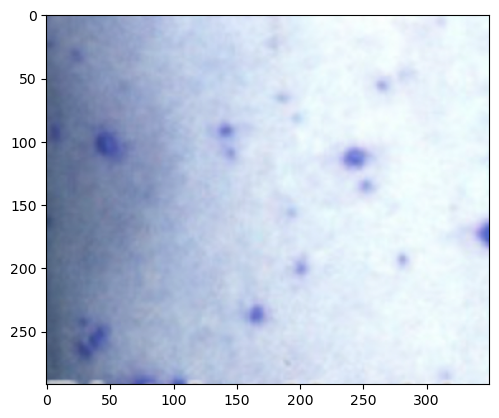

./MCSI/images/chickenpox_8.png
96
(3, 224, 224)


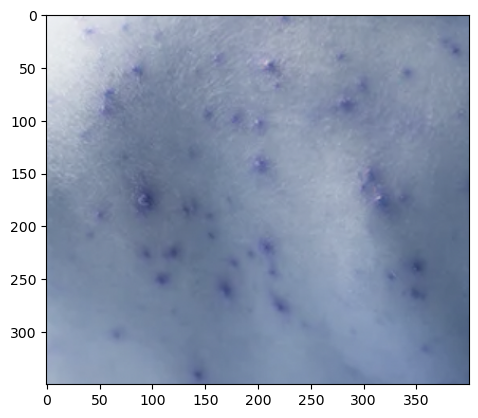

./MCSI/images/chickenpox_34.png
97
(3, 224, 224)


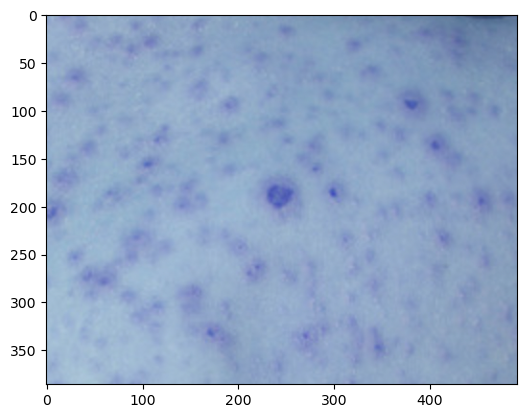

./MCSI/images/chickenpox_20.png
98
(3, 224, 224)
(3, 224, 224)


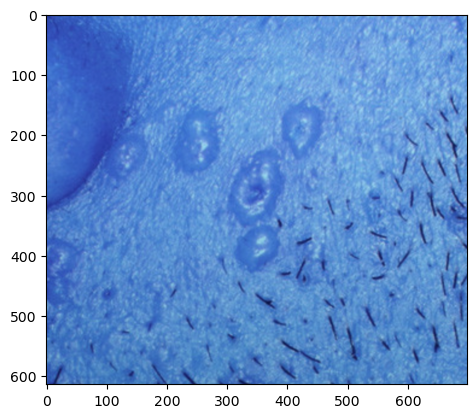

./MCSI/images/chickenpox_21.png
99
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)


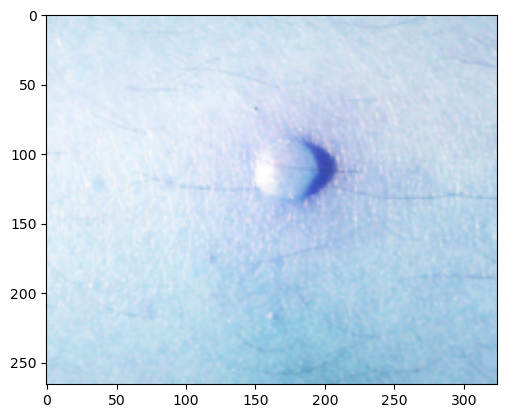

./MCSI/images/chickenpox_35.png
100
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224)
(3, 224, 224

In [9]:
X_train_multi = [[] , [] , [] , []]
y_train_multi = [[] , [] , [] , []]

X_train_bin = [[] , []]
y_train_bin = [[] , []]

count = 0
for i in range(400):
    if meta['diagnostic'][i]=='monkeypox':
        path = './MCSI/images/'+meta['img_id'][i]
        
        # print(img.shape)
        img = cv2.imread(path)

        patches_images, patches_labels = get_image_pathes(img, (224,224,3) , [1 , 0 , 0 , 0])
      
        
       
        X_train_multi[0].extend(patches_images)
        y_train_multi[0].extend(patches_labels)
        


        # X_train_bin[0].append(img)
        # y_train_bin[0].append([0])
 
    elif meta['diagnostic'][i]=='normal':
        
        path = './MCSI/images/'+meta['img_id'][i]
        img = cv2.imread(path)

        # plt.imshow(  img.astype(np.uint8)  )
        # plt.show()
        # print(path)
        # print(img.shape)
        patches_images, patches_labels = get_image_pathes(img, (224,224,3) , [0 , 1 , 0 , 0])
      
        
       
        X_train_multi[1].extend(patches_images)
        y_train_multi[1].extend(patches_labels)
        

        
    elif meta['diagnostic'][i]=='chickenpox':
        
        path = './MCSI/images/'+meta['img_id'][i]
        img = cv2.imread(path)
        
        # plt.imshow(  img.astype(np.uint8)  )
        # plt.show()
        # print(path)
        # count+=1
        # print(count)
# 
        # plt.imshow(  img.astype(np.uint8)  )
        # plt.show()
        # print(path)
        # print(img.shape)

        patches_images, patches_labels = get_image_pathes(img, (224,224,3) , [ 0 , 0 , 1 , 0])
      
        
       
        X_train_multi[2].extend(patches_images)
        y_train_multi[2].extend(patches_labels)
  
     
            
        
    else:
       
        path = './MCSI/images/'+meta['img_id'][i] +'.png'

        # plt.imshow(  img.astype(np.uint8)  )
        # plt.show()
        # print(path)
        img = cv2.imread(path)
        # print(img.shape)
        # img = cv2.resize(img, (224,224)).astype(np.float32)

        # img = np.moveaxis(img, -1, 0)
        # X_train_multi[3].append(img)
        # y_train_multi[3].append([ 0 , 0 , 0 , 1])
        patches_images, patches_labels = get_image_pathes(img, (224,224,3) , [ 0 , 0 , 0 , 1])
      
        
       
        X_train_multi[3].extend(patches_images)
        y_train_multi[3].extend(patches_labels)

# X_train_bin[1]+= X_train_multi[1][:33]+X_train_multi[2][:33]+X_train_multi[3][:34]
# y_train_bin[1]=[[1]]*100

### 180 images of chicken pox and 100 of other

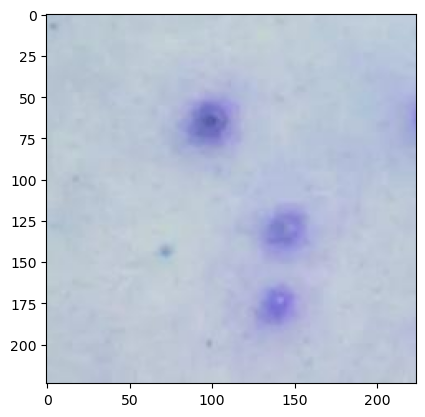

In [10]:
plt.imshow(  np.moveaxis(X_train_multi[0][0], 0, -1).astype(np.uint8)  )

In [13]:
X_train_multi[2] = X_train_multi[2][0:100]
X_train_multi[1] = X_train_multi[1][0:100]
X_train_multi[3] = X_train_multi[3][:100]

In [16]:
np.array(X_train_multi[3]).shape


(100, 3, 224, 224)

In [14]:
np.array(X_train_multi).shape

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (4,) + inhomogeneous part.

In [34]:
len(y_train_bin[1])

TypeError: 'int' object is not callable

In [ ]:
# data_zip = shuffle_multi_zip(X_train_multi,y_train_multi)

In [17]:
X_train_shuffle_multi , y_train_shuffle_multi =shuffle_multi(X_train_multi,y_train_multi)


100
200


In [13]:
# X_train_final_multi , y_train_final_multi = keep_equal_and_shuffle(X_train_multi , y_train_multi , imbalanced=0)


0
0
0
0
1
1
1
1
2
2
2
2
3
3
3
3
4
4
4
4
5
5
5
5
6
6
6
6
7
7
7
7
8
8
8
8
9
9
9
9


In [15]:
np.array(X_train_final_multi[9]).shape

(42, 3, 224, 224)

In [ ]:
# Increase the dataset size so I have 12 folds now instead of 10 as 80 new images of chiucken pox have been added

In [20]:
y_train_final_multi[8]

array([[0, 0, 0, 1],
       [0, 1, 0, 0],
       [0, 0, 1, 0],
       [1, 0, 0, 0],
       [0, 1, 0, 0],
       [0, 1, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [0, 0, 0, 1],
       [0, 0, 1, 0],
       [0, 0, 1, 0],
       [0, 0, 0, 1],
       [0, 0, 0, 1],
       [0, 0, 1, 0],
       [0, 0, 0, 1],
       [0, 1, 0, 0],
       [0, 1, 0, 0],
       [0, 0, 1, 0],
       [0, 0, 0, 1],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [0, 0, 1, 0],
       [0, 1, 0, 0],
       [0, 0, 1, 0],
       [0, 0, 0, 1],
       [0, 0, 0, 1],
       [0, 0, 1, 0],
       [0, 0, 0, 1],
       [0, 0, 0, 1],
       [0, 0, 1, 0],
       [0, 1, 0, 0],
       [0, 0, 0, 1],
       [0, 1, 0, 0],
       [0, 0, 0, 1],
       [0, 1, 0, 0],
       [0, 0, 0, 1],
       [1, 0, 0, 0],
       [0, 1, 0, 0],
       [0, 0, 0, 1],
       [0, 1, 0, 0]])

In [18]:
#divide into 10 folds
len=40
k=10
X_train_final_multi = []
y_train_final_multi = []
# X_train_final_bin = []
# y_train_final_bin = []

for i in range(k):
    #multi
    
    X_train_final_multi.append(X_train_shuffle_multi[i*len:i*len+len])
    y_train_final_multi.append(y_train_shuffle_multi[i*len:i*len+len])

    # X_train_final_bin.append(X_train_shuffle_bin[i*20:i*20+20]) 
    # y_train_final_bin.append(y_train_shuffle_bin[i*20:i*20+20]) 
    

In [29]:
y_train_final_multi[0].shape

(40, 4)

In [19]:
count = 0
for i in range(len(y_train_final_multi[0])):
    print(y_train_final_multi[0][i])
    


TypeError: 'int' object is not callable

In [24]:
X_train_final_multi = np.array(X_train_final_multi)
y_train_final_multi = np.array(y_train_final_multi).astype(np.float32)

# X_train_final_bin = np.array(X_train_final_bin)
# y_train_final_bin = np.array(y_train_final_bin).astype(np.float32)

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (12,) + inhomogeneous part.

In [19]:

X_train_final_multi.shape

(10, 42, 3, 224, 224)

In [20]:
np.save('./X_train_final_multi_10_folds_40_each_equal_' , X_train_final_multi)
np.save('./y_train_final_multi_10_folds_40_each_equal__' , y_train_final_multi)

# np.save('./X_train_final_bin' , X_train_final_bin)
# np.save('./y_train_final_bin' , y_train_final_bin)